# Capstone Project (Week 3)
## Seattle Collision Data
### Applied Data Science Capstone on Coursera

# Contents
* [Introduction/Business Problem](#a01)
* [Data](#a02)
* [Analysis](#a03)
* [Data Cleaning, Pre-processing, & Feature Engineering](#a04)
* [Models](#a05)
* [Results & Discussion](#a06)
* [Conclusion](#a07)

# Introduction/Business Problem <a name="a01"></a>

The goal of this capstone project is to predict injury collisions (SEVERITYCODE = 2) and property damage collisions (SEVERITYCODE = 1) using the data set explained in the following section.

This report is relevant to those who are interested in preventing or reducing injury collisions and property damage.

# Data <a name="a02"></a>

The title of the data set is "Collisions—All Years". The data set includes information on all collisions provided by SPD and recorded by Traffic Records. This includes all types of collisions. Collisions will display at the intersection or
mid-block of a segment. The timeframe is 2004 to present. The update frequency of the data set is weekly.

## Download Links

- The data set can be found via this <a href="https://s3.us.cloud-object-storage.appdomain.cloud/cf-courses-data/CognitiveClass/DP0701EN/version-2/Data-Collisions.csv" target="_blank">link</a>.

- Its metadata can be found via this <a href="https://s3.us.cloud-object-storage.appdomain.cloud/cf-courses-data/CognitiveClass/DP0701EN/version-2/Metadata.pdf" target="_blank">link</a>.

# Analysis <a name="a03"></a>

In [1]:
import os
import platform; print(platform.platform())
import sys; print("Python", sys.version)
import pandas as pd; print("Pandas", pd.__version__)
import string
import numpy as np; print("NumPy", np.__version__)
import matplotlib.pyplot as plt
import seaborn as sns
import scipy; print("SciPy", scipy.__version__)
import sklearn; print("Scikit-Learn", sklearn.__version__)

Linux-4.19.76-linuxkit-x86_64-with-glibc2.2.5
Python 3.8.5 (default, Aug  5 2020, 08:22:02) 
[GCC 8.3.0]
Pandas 1.1.1
NumPy 1.19.1
SciPy 1.5.2
Scikit-Learn 0.23.2


In [2]:
# Read CSV file
collisions_df = pd.read_csv("data/data-collisions.csv", encoding="utf8")

<AxesSubplot:xlabel='count', ylabel='SEVERITYCODE'>

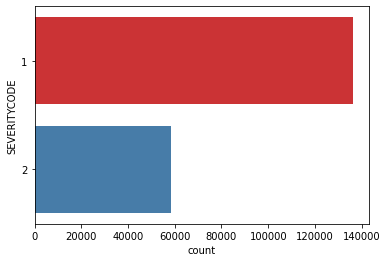

In [3]:
# Plot countplot showing SEVERITYCODE count
'''
A code that corresponds to the severity of the
collision:
• 3—fatality
• 2b—serious injury
• 2—injury
• 1—prop damage
• 0—unknown
'''
sns.countplot(y="SEVERITYCODE", data=collisions_df, palette="Set1")

In [4]:
# Show columns
collisions_df.columns

Index(['SEVERITYCODE', 'X', 'Y', 'OBJECTID', 'INCKEY', 'COLDETKEY', 'REPORTNO',
       'STATUS', 'ADDRTYPE', 'INTKEY', 'LOCATION', 'EXCEPTRSNCODE',
       'EXCEPTRSNDESC', 'SEVERITYCODE.1', 'SEVERITYDESC', 'COLLISIONTYPE',
       'PERSONCOUNT', 'PEDCOUNT', 'PEDCYLCOUNT', 'VEHCOUNT', 'INCDATE',
       'INCDTTM', 'JUNCTIONTYPE', 'SDOT_COLCODE', 'SDOT_COLDESC',
       'INATTENTIONIND', 'UNDERINFL', 'WEATHER', 'ROADCOND', 'LIGHTCOND',
       'PEDROWNOTGRNT', 'SDOTCOLNUM', 'SPEEDING', 'ST_COLCODE', 'ST_COLDESC',
       'SEGLANEKEY', 'CROSSWALKKEY', 'HITPARKEDCAR'],
      dtype='object')

In [5]:
# Display shape of dataframe
collisions_df.shape

(194673, 38)

In [6]:
# Display data info
collisions_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 194673 entries, 0 to 194672
Data columns (total 38 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   SEVERITYCODE    194673 non-null  int64  
 1   X               189339 non-null  float64
 2   Y               189339 non-null  float64
 3   OBJECTID        194673 non-null  int64  
 4   INCKEY          194673 non-null  int64  
 5   COLDETKEY       194673 non-null  int64  
 6   REPORTNO        194673 non-null  object 
 7   STATUS          194673 non-null  object 
 8   ADDRTYPE        192747 non-null  object 
 9   INTKEY          65070 non-null   float64
 10  LOCATION        191996 non-null  object 
 11  EXCEPTRSNCODE   84811 non-null   object 
 12  EXCEPTRSNDESC   5638 non-null    object 
 13  SEVERITYCODE.1  194673 non-null  int64  
 14  SEVERITYDESC    194673 non-null  object 
 15  COLLISIONTYPE   189769 non-null  object 
 16  PERSONCOUNT     194673 non-null  int64  
 17  PEDCOUNT  

In [7]:
# Display first five rows of dataframe
collisions_df.head()

,SEVERITYCODE,X,Y,OBJECTID,INCKEY,COLDETKEY,REPORTNO,STATUS,ADDRTYPE,INTKEY,...,ROADCOND,LIGHTCOND,PEDROWNOTGRNT,SDOTCOLNUM,SPEEDING,ST_COLCODE,ST_COLDESC,SEGLANEKEY,CROSSWALKKEY,HITPARKEDCAR
0,2,-122.323148,47.703140,1,1307,1307,3502005,Matched,Intersection,37475.0,...,Wet,Daylight,NaN,NaN,NaN,10,Entering at angle,0,0,N
1,1,-122.347294,47.647172,2,52200,52200,2607959,Matched,Block,NaN,...,Wet,Dark - Street Lights On,NaN,6354039.0,NaN,11,From same direction - both going straight - bo...,0,0,N
2,1,-122.334540,47.607871,3,26700,26700,1482393,Matched,Block,NaN,...,Dry,Daylight,NaN,4323031.0,NaN,32,One parked--one moving,0,0,N
3,1,-122.334803,47.604803,4,1144,1144,3503937,Matched,Block,NaN,...,Dry,Daylight,NaN,NaN,NaN,23,From same direction - all others,0,0,N
4,2,-122.306426,47.545739,5,17700,17700,1807429,Matched,Intersection,34387.0,...,Wet,Daylight,NaN,4028032.0,NaN,10,Entering at angle,0,0,N


In [8]:
# Calculate percentage of missing values from data set
column_na = round(100*(collisions_df.isna().sum()/len(collisions_df)), 2)
column_nunique = collisions_df.nunique()    
df_summary = pd.DataFrame({"DATA_TYPE": collisions_df.dtypes,
                           "PERCENT_MISSING_VALUES": column_na,
                           "TOTAL_UNIQUE_VALUES": column_nunique}).sort_values(by=["PERCENT_MISSING_VALUES"],
                           ascending=True)
df_summary.head(25)
del column_na, column_nunique
df_summary

,DATA_TYPE,PERCENT_MISSING_VALUES,TOTAL_UNIQUE_VALUES
SEVERITYCODE,int64,0.00,2
SEGLANEKEY,int64,0.00,1955
SDOT_COLDESC,object,0.00,39
SDOT_COLCODE,int64,0.00,39
INCDTTM,object,0.00,162058
INCDATE,object,0.00,5985
VEHCOUNT,int64,0.00,13
CROSSWALKKEY,int64,0.00,2198
PEDCOUNT,int64,0.00,7
PERSONCOUNT,int64,0.00,47


In [9]:
# Display all unique values in SEVERITYCODE
collisions_df["SEVERITYCODE"].unique()

array([2, 1])

In [10]:
# Add features: year, month, day, weekday, AMPM, HOUR
collisions_df["INCDATE"] = collisions_df["INCDATE"].str.slice(stop=10)
collisions_df["INCDATE"] = collisions_df["INCDATE"].astype("datetime64[ns]")
collisions_df["year"] = collisions_df["INCDATE"].dt.year
collisions_df["month"] = collisions_df["INCDATE"].dt.month
collisions_df["day"] = collisions_df["INCDATE"].dt.day
collisions_df["weekday"] = collisions_df["INCDATE"].dt.weekday

collisions_df["INCDTTM"].unique()
collisions_df["AMPM"] = collisions_df["INCDTTM"].str.slice(start=-2)
collisions_df["AMPM"] = np.where((collisions_df["AMPM"] == "AM") | 
                        (collisions_df["AMPM"] == "PM"), 
                        collisions_df["AMPM"], np.nan)

collisions_df["TIME"] = collisions_df["INCDTTM"].str.slice(start=-11)
collisions_df["HOUR"] = collisions_df["TIME"].str.slice(stop=2)
collisions_df["HOUR"] = collisions_df["HOUR"].str.replace("/","")
collisions_df["HOUR"] = collisions_df["HOUR"].str.replace(" ","")
collisions_df["HOUR"].unique()
collisions_df["HOUR"] = collisions_df["HOUR"].astype(int)
collisions_df["HOUR"] = np.where(collisions_df["AMPM"] == "PM", collisions_df["HOUR"]+12, collisions_df["HOUR"])

## Exploratory Data Analysis
The following plot and table indicate that intersections have a higher percentage of injury collisions.

<AxesSubplot:xlabel='count', ylabel='SEVERITYCODE'>

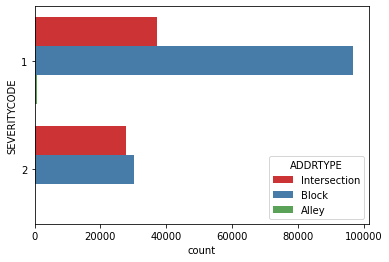

In [11]:
sns.countplot(y="SEVERITYCODE", hue="ADDRTYPE", data=collisions_df, palette="Set1")

In [12]:
collisions_df[["SEVERITYCODE"]].groupby(collisions_df["ADDRTYPE"]).mean().sort_values(by=["SEVERITYCODE"], ascending=False)

,SEVERITYCODE
ADDRTYPE,
Intersection,1.427524
Block,1.237115
Alley,1.109188


<AxesSubplot:xlabel='count', ylabel='month'>

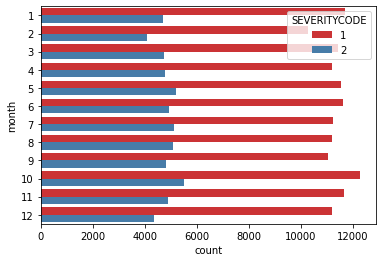

In [13]:
# The following graph shows the count of injury collision by severity code
sns.countplot(y="month", hue="SEVERITYCODE", data=collisions_df, palette="Set1")

In [14]:
collisions_df[["SEVERITYCODE"]].groupby(collisions_df["month"]).mean().sort_values(by=["SEVERITYCODE"], ascending=False)

,SEVERITYCODE
month,
7,1.313921
8,1.311856
5,1.309968
10,1.309264
9,1.303265
4,1.298035
6,1.297477
11,1.295441
3,1.293189


In [15]:
# Calculate percentage of collisions by ST_COLCODE, a code provided by the state that describes the collision

collisions_df[["SEVERITYCODE"]].groupby(collisions_df["ST_COLCODE"]).mean().sort_values(by=["SEVERITYCODE"], ascending=False)

,SEVERITYCODE
ST_COLCODE,
49,2.000000
87,2.000000
87,2.000000
4,1.950000
7,1.944444
...,...
65,1.000000
82,1.000000
60,1.000000


In [16]:
# Percentage of collisions by COLLISIONTYPE
collisions_df[["SEVERITYCODE"]].groupby(collisions_df["COLLISIONTYPE"]).mean().sort_values(by=["SEVERITYCODE"], ascending=False)

,SEVERITYCODE
COLLISIONTYPE,
Pedestrian,1.898305
Cycles,1.876085
Head On,1.430830
Rear Ended,1.430361
Left Turn,1.394877
Angles,1.392917
Other,1.257858
Right Turn,1.206022
Sideswipe,1.134666


The following heatmaps were generated to gain a deeper understanding of the data set and relationships among attributes. A darker color indicates a higher percentage.

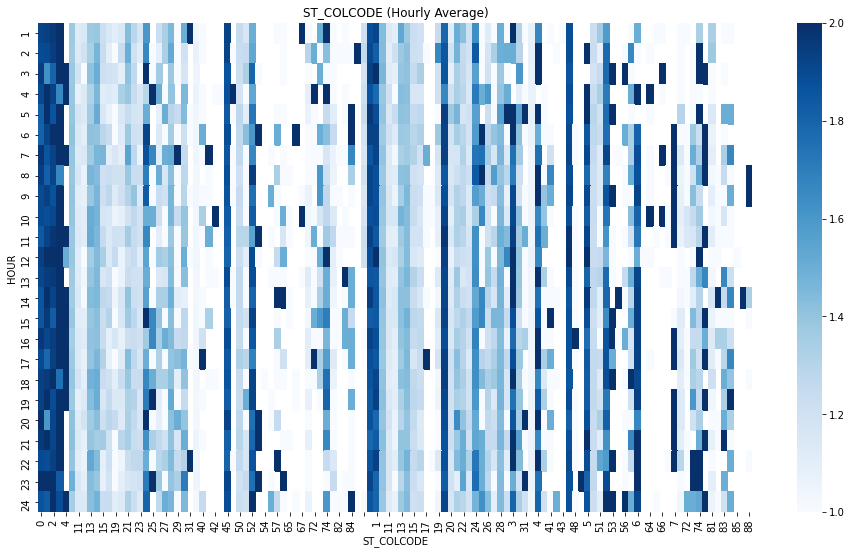

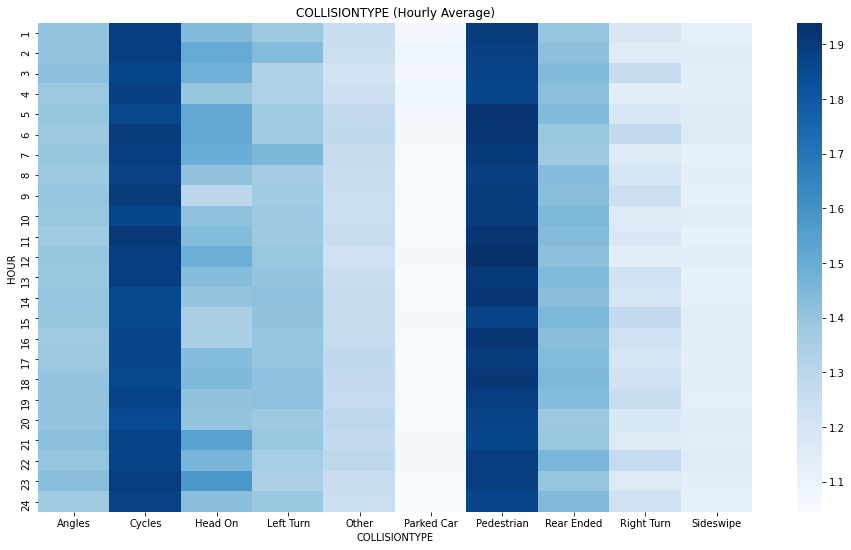

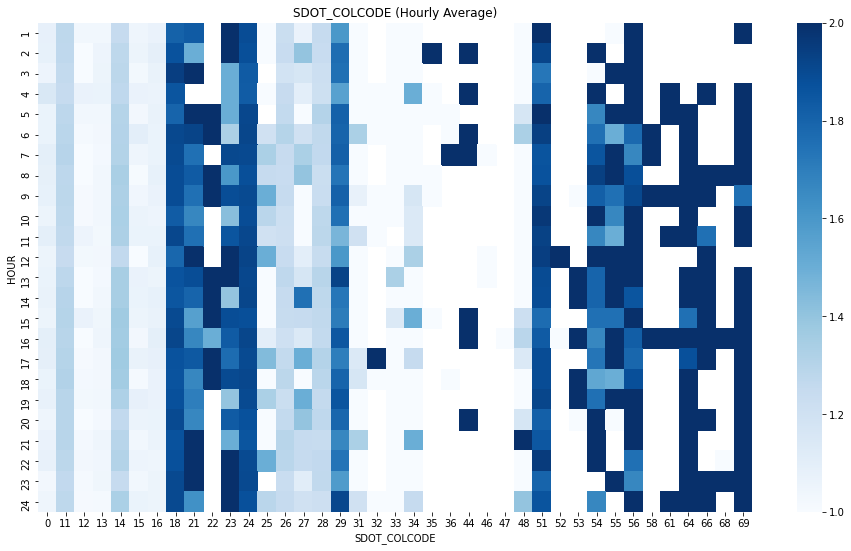

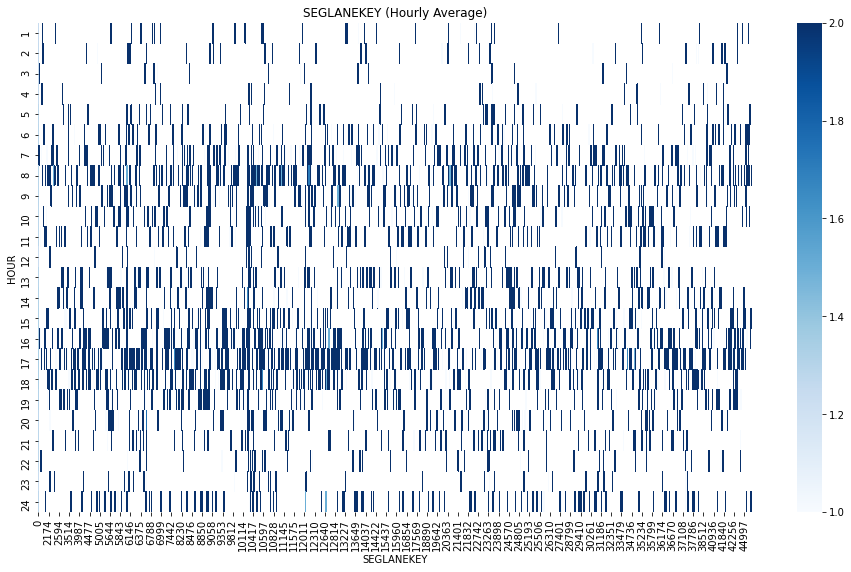

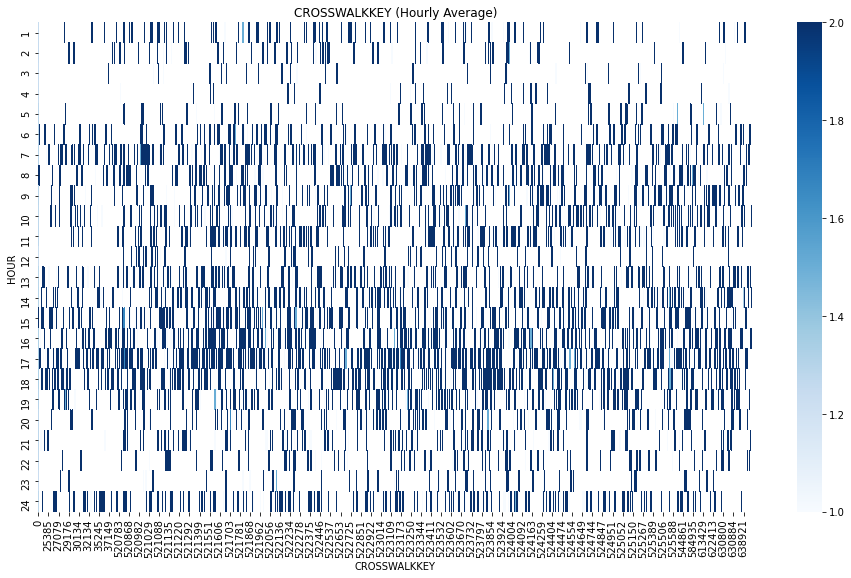

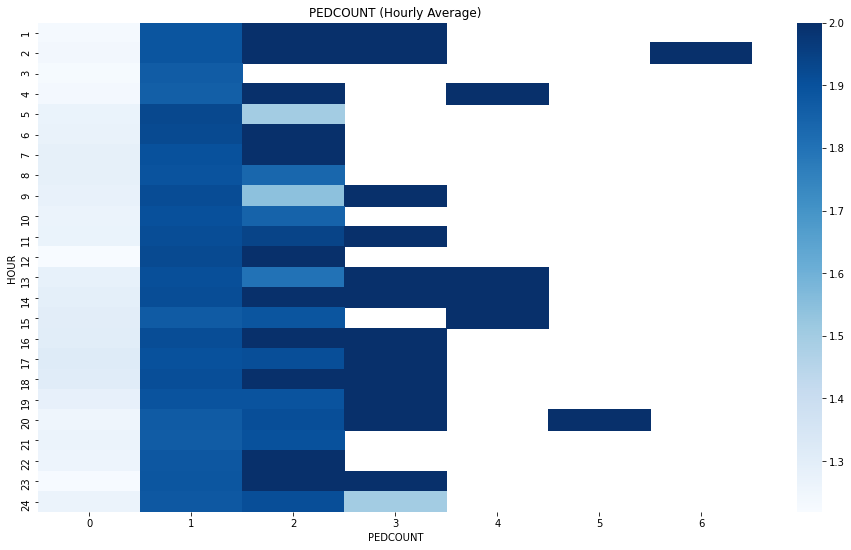

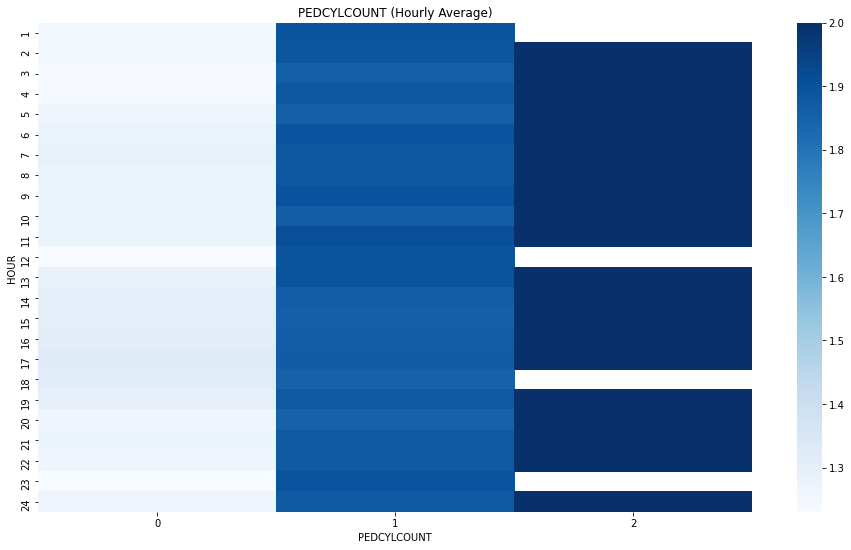

In [17]:
features = ["ST_COLCODE","COLLISIONTYPE","SDOT_COLCODE","SEGLANEKEY","CROSSWALKKEY","PEDCOUNT",
            "PEDCYLCOUNT"]
for i in features:
    fig, ax = plt.subplots(figsize=(16,9))
    hrvsday = collisions_df.pivot_table(values="SEVERITYCODE",index="HOUR",columns=i,aggfunc="mean")
    ax.set_title(i + " (Hourly Average)")
    sns.heatmap(hrvsday,cmap="Blues", ax=ax) # Monday = 0; Sunday = 6
    plt.show()

# Data Cleaning, Pre-processing, & Feature Engineering <a name="a04"></a>
In this section, methods are applied to clean and pre-process the data for analysis. For example, we split the data into high risk and low risk in order to better apply one hot encoding. Otherwise, noise in the data might potentially be problematic.

In [18]:
collisions_df.dtypes
collisions_df["ST_COLCODE"].unique()
collisions_df["ST_COLCODE"] = collisions_df["ST_COLCODE"].astype("category")
collisions_df["ST_COLCODE"] = collisions_df["ST_COLCODE"].astype("str")
collisions_df["ST_COLCODE"] = collisions_df["ST_COLCODE"].replace(" ",np.nan)
collisions_df["ST_COLCODE"] = collisions_df["ST_COLCODE"].astype(float)

collisions_df.columns
collisions_df["High_Risk_ST_COLCODE"] = np.where((collisions_df["ST_COLCODE"] == 0) | 
                            (collisions_df["ST_COLCODE"] == 1) |
                            (collisions_df["ST_COLCODE"] == 2) |
                            (collisions_df["ST_COLCODE"] == 3) |
                            (collisions_df["ST_COLCODE"] == 4) |
                            (collisions_df["ST_COLCODE"] == 5) |
                            (collisions_df["ST_COLCODE"] == 6) |
                            (collisions_df["ST_COLCODE"] == 7) |
                            (collisions_df["ST_COLCODE"] == 8) |
                            (collisions_df["ST_COLCODE"] == 24) |
                            (collisions_df["ST_COLCODE"] == 45) |
                            (collisions_df["ST_COLCODE"] == 49) |
                            (collisions_df["ST_COLCODE"] == 52) |
                            (collisions_df["ST_COLCODE"] == 53) |
                            (collisions_df["ST_COLCODE"] == 87) |
                            (collisions_df["ST_COLCODE"] == 10) |
                            (collisions_df["ST_COLCODE"] == 13) |
                            (collisions_df["ST_COLCODE"] == 14) |
                            (collisions_df["ST_COLCODE"] == 21) |
                            (collisions_df["ST_COLCODE"] == 25) |
                            (collisions_df["ST_COLCODE"] == 28) |
                            (collisions_df["ST_COLCODE"] == 30) |
                            (collisions_df["ST_COLCODE"] == 66) |
                            (collisions_df["ST_COLCODE"] == 73) |
                            (collisions_df["ST_COLCODE"] == 74) |
                            (collisions_df["ST_COLCODE"] == 84) |
                            (collisions_df["ST_COLCODE"] == 88)
                            
                        ,1, 0)

In [19]:
collisions_df["High_Risk_COLLISIONTYPE"] = np.where((collisions_df["COLLISIONTYPE"] == "Pedestrian") | 
                            (collisions_df["COLLISIONTYPE"] == "Cycles") |
                            (collisions_df["COLLISIONTYPE"] == "Head On") |
                            (collisions_df["COLLISIONTYPE"] == "Rear Ended")                            
                            ,1, 0)

In [20]:
collisions_df["High_Risk_SDOT_COLCODE"] = np.where((collisions_df["SDOT_COLCODE"] == 44) | 
                            (collisions_df["SDOT_COLCODE"] == 58) |
                            (collisions_df["SDOT_COLCODE"] == 61) |
                            (collisions_df["SDOT_COLCODE"] == 69) |
                            (collisions_df["SDOT_COLCODE"] == 64) |
                            (collisions_df["SDOT_COLCODE"] == 66) |
                            (collisions_df["SDOT_COLCODE"] == 22) |
                            (collisions_df["SDOT_COLCODE"] == 24) |
                            (collisions_df["SDOT_COLCODE"] == 56) |
                            (collisions_df["SDOT_COLCODE"] == 51) |
                            (collisions_df["SDOT_COLCODE"] == 18) |
                            (collisions_df["SDOT_COLCODE"] == 55) |
                            (collisions_df["SDOT_COLCODE"] == 53) |
                            (collisions_df["SDOT_COLCODE"] == 21) |
                            (collisions_df["SDOT_COLCODE"] == 54) |
                            (collisions_df["SDOT_COLCODE"] == 29) |
                            (collisions_df["SDOT_COLCODE"] == 23) |
                            (collisions_df["SDOT_COLCODE"] == 68) |
                            (collisions_df["SDOT_COLCODE"] == 52) 
                            ,1, 0)

In [21]:
collisions_df["High_Risk_SEGLANEKEY"] = np.where((collisions_df["SEGLANEKEY"] > 0)
                            ,1, 0)

In [22]:
collisions_df["High_Risk_CROSSWALKKEY"] = np.where((collisions_df["CROSSWALKKEY"] > 0)
                            ,1, 0)

In [23]:
collisions_df["High_Risk_PEDCOUNT"] = np.where((collisions_df["PEDCOUNT"] > 0)
                            ,1, 0)

In [24]:
collisions_df["High_Risk_PEDCYLCOUNT"] = np.where((collisions_df["PEDCYLCOUNT"] > 0)
                            ,1, 0)

In [25]:
# Drop unused or missing variables
collisions_df = collisions_df.drop(columns=["OBJECTID","INCKEY","COLDETKEY","SDOTCOLNUM", "INCDATE",
       "INCDTTM", "REPORTNO","COLDETKEY", "INCKEY", "OBJECTID","EXCEPTRSNDESC",
       "ST_COLDESC","SDOT_COLDESC","SEVERITYDESC","SEVERITYCODE.1",
       "EXCEPTRSNDESC", "INATTENTIONIND", "INTKEY", "EXCEPTRSNCODE",
       "SDOTCOLNUM","TIME","SDOT_COLCODE","ST_COLCODE","PEDROWNOTGRNT",
       "PERSONCOUNT","PEDCOUNT","COLLISIONTYPE","STATUS","year","JUNCTIONTYPE",
       "HITPARKEDCAR","PEDCYLCOUNT","VEHCOUNT","AMPM",
       "SEGLANEKEY", "CROSSWALKKEY", "SPEEDING"])

In [26]:
# Convert to category
col = ["month", "day", "ADDRTYPE", "UNDERINFL", "HOUR"]

for col in col:
    collisions_df[col] = collisions_df[col].astype("category")

collisions_df.info()

col_na = round(100*(collisions_df.isna().sum()/len(collisions_df)), 2)
col_nunique = collisions_df.nunique()
df_summary = pd.DataFrame({"DATA_TYPE": collisions_df.dtypes,
                           "PERCENT_MISSING_VALUES": col_na,
                           "TOTAL_UNIQUE_VALUES": col_nunique}).sort_values(by=["PERCENT_MISSING_VALUES"],
                           ascending=False)
df_summary.head(25)
del col_na, col_nunique
df_summary

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 194673 entries, 0 to 194672
Data columns (total 20 columns):
 #   Column                   Non-Null Count   Dtype   
---  ------                   --------------   -----   
 0   SEVERITYCODE             194673 non-null  int64   
 1   X                        189339 non-null  float64 
 2   Y                        189339 non-null  float64 
 3   ADDRTYPE                 192747 non-null  category
 4   LOCATION                 191996 non-null  object  
 5   UNDERINFL                189789 non-null  category
 6   WEATHER                  189592 non-null  object  
 7   ROADCOND                 189661 non-null  object  
 8   LIGHTCOND                189503 non-null  object  
 9   month                    194673 non-null  category
 10  day                      194673 non-null  category
 11  weekday                  194673 non-null  int64   
 12  HOUR                     194673 non-null  category
 13  High_Risk_ST_COLCODE     194673 non-null  in

,DATA_TYPE,PERCENT_MISSING_VALUES,TOTAL_UNIQUE_VALUES
Y,float64,2.74,23839
X,float64,2.74,23563
LIGHTCOND,object,2.66,9
WEATHER,object,2.61,11
ROADCOND,object,2.57,9
UNDERINFL,category,2.51,4
LOCATION,object,1.38,24102
ADDRTYPE,category,0.99,3
SEVERITYCODE,int64,0.00,2
High_Risk_COLLISIONTYPE,int64,0.00,2


In [27]:
# Second stage of data set
collisions_df = collisions_df[["SEVERITYCODE", "X", "Y","ADDRTYPE","High_Risk_ST_COLCODE",
             "High_Risk_COLLISIONTYPE","HOUR","High_Risk_SDOT_COLCODE",
             "High_Risk_SEGLANEKEY","High_Risk_CROSSWALKKEY","High_Risk_PEDCOUNT","High_Risk_PEDCYLCOUNT"]]


In [28]:
# Perform one hot encoding to transform features to binary
collisions_df = pd.get_dummies(collisions_df, columns=["ADDRTYPE","High_Risk_ST_COLCODE",
                                     "High_Risk_COLLISIONTYPE","HOUR",
                                     "High_Risk_SDOT_COLCODE","High_Risk_SEGLANEKEY",
                                     "High_Risk_CROSSWALKKEY","High_Risk_PEDCOUNT","High_Risk_PEDCYLCOUNT"])

In [29]:
# Drop NA, final data set
collisions_df = collisions_df.dropna(how="any")

In [30]:
# Split train test dataset
X = collisions_df.drop(columns=["SEVERITYCODE"])
y = collisions_df["SEVERITYCODE"]

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


## Balancing Targets
Based on the first plot created in this notebook, the data set is unbalanced. Therefore, we must perform sampling methods to avoid any potential unbalanced issues. Over sampling is selected in this case, and the author notes that under sampling could also be used.

In [31]:
# Over sampling train data
from imblearn.over_sampling import RandomOverSampler
ros = RandomOverSampler(random_state=0)
X_train, y_train = ros.fit_resample(X_train, y_train)
X_train = pd.DataFrame(data=X_train)
X_train.columns = list(X_test)

# Models <a name="a04"></a>

This focus of this project is on predicting injury and property damage collisions; therefore, this is a classification problem.

The following models are evaluated:
- MLPClassifier
- Naive Bayes
- XGBoost

These were selected due to their performance and popularity in the literature.

## MLPClassifier

A multilayer perceptron (MLP) is a class of feedforward artificial neural network (ANN). The term MLP is used ambiguously, sometimes loosely to any feedforward ANN, sometimes strictly to refer to networks composed of multiple layers of perceptrons (with threshold activation). Multilayer perceptrons are sometimes colloquially referred to as "vanilla" neural networks, especially when they have a single hidden layer.

For further information, see [this Wikipedia article](https://en.wikipedia.org/wiki/Multilayer_perceptron).

In [32]:
''' MLPClassifier '''
import os
import random
random.seed (2)
from sklearn.neural_network import MLPClassifier

clf = MLPClassifier(hidden_layer_sizes=(15,10,5,3), activation="logistic",
                    solver="adam", alpha=0.001, batch_size="auto",
                    learning_rate="invscaling", learning_rate_init=0.0001,
                    power_t=0.5, max_iter=200, shuffle=True, random_state=None,
                    tol=0.0001, verbose=False, warm_start=False, momentum=0.9,
                    nesterovs_momentum=True, early_stopping=False,
                    validation_fraction=0.1, beta_1=0.1, beta_2=0.9999,
                    epsilon=1e-08, n_iter_no_change=10)
clf.fit(X_train, y_train)
clf_train_pred = clf.predict(X_train)
clf_test_pred = clf.predict(X_test)

# Evaluation
from sklearn.metrics import roc_auc_score, roc_curve, auc,mean_squared_error\
                            ,mean_absolute_error, confusion_matrix\
                            ,classification_report, accuracy_score, precision_score
                            
# Confusion Matrix
cm = confusion_matrix(y_test,clf_test_pred)
print("Test_Confusion_Matrix: \n",cm)
print("Train_ROC_AUC_Score: ",roc_auc_score(y_train, clf_train_pred))
print("Test_ROC_AUC_Score: ",roc_auc_score(y_test, clf_test_pred))

# Sensitivity
total=sum(sum(cm))
sensitivity1 = cm[1,1]/(cm[1,0]+cm[1,1])
print("Test_Sensitivity : ", sensitivity1 )

# Specificity
specificity1 = cm[0,0]/(cm[0,0]+cm[0,1])
print("Test_Specificity : ", specificity1)

# Accuracy
print("Test_Accuracy_Score:",accuracy_score(y_test, clf_test_pred))
print(classification_report(y_test, clf_test_pred))

Test_Confusion_Matrix: 
 [[16792  9765]
 [ 2378  8933]]
Train_ROC_AUC_Score:  0.7115431935190792
Test_ROC_AUC_Score:  0.711031256769306
Test_Sensitivity :  0.789762178410397
Test_Specificity :  0.6323003351282148
Test_Accuracy_Score: 0.6793334741734446
              precision    recall  f1-score   support

           1       0.88      0.63      0.73     26557
           2       0.48      0.79      0.60     11311

    accuracy                           0.68     37868
   macro avg       0.68      0.71      0.66     37868
weighted avg       0.76      0.68      0.69     37868



## Naive Bayes

In statistics, Naive Bayes classifiers are a family of simple "probabilistic classifiers" based on applying Bayes' theorem with strong (naïve) independence assumptions between the features. They are among the simplest Bayesian network models.[1] But they could be coupled with Kernel density estimation and achieve higher accuracy levels.

For further information, see [this Wikipedia article](https://en.wikipedia.org/wiki/Naive_Bayes_classifier).

In [33]:
''' Naive Bayes '''
import os
import random
random.seed (2)

from sklearn.naive_bayes import GaussianNB
from sklearn.inspection import permutation_importance
clf = GaussianNB()
clf.fit(X_train, y_train)
clf_train_pred = clf.predict(X_train)
clf_test_pred = clf.predict(X_test)

import eli5 
from eli5.sklearn import PermutationImportance
from IPython.display import display
perm = PermutationImportance(clf, random_state=1).fit(X_test, y_test) 
html_obj = eli5.show_weights(perm, feature_names = X_test.columns.tolist())

# Evaluation
from sklearn.metrics import roc_auc_score, roc_curve, auc,mean_squared_error\
                            ,mean_absolute_error, confusion_matrix\
                            ,classification_report, accuracy_score, precision_score
                            
# Confusion Matrix
cm = confusion_matrix(y_test,clf_test_pred)
print("Test_Confusion_Matrix: \n",cm)
print("Train_ROC_AUC_Score: ",roc_auc_score(y_train, clf_train_pred))
print("Test_ROC_AUC_Score: ",roc_auc_score(y_test, clf_test_pred))

# Sensitivity
total=sum(sum(cm))
sensitivity1 = cm[1,1]/(cm[1,0]+cm[1,1])
print("Test_Sensitivity : ", sensitivity1 )

# Specificity
specificity1 = cm[0,0]/(cm[0,0]+cm[0,1])
print("Test_Specificity : ", specificity1)

# Accuracy
print("Test_Accuracy_Score:",accuracy_score(y_test, clf_test_pred))
print(classification_report(y_test, clf_test_pred))

Test_Confusion_Matrix: 
 [[26273   284]
 [ 9043  2268]]
Train_ROC_AUC_Score:  0.5936080405814658
Test_ROC_AUC_Score:  0.5949093980930091
Test_Sensitivity :  0.20051277517460878
Test_Specificity :  0.9893060210114094
Test_Accuracy_Score: 0.7536970529206718
              precision    recall  f1-score   support

           1       0.74      0.99      0.85     26557
           2       0.89      0.20      0.33     11311

    accuracy                           0.75     37868
   macro avg       0.82      0.59      0.59     37868
weighted avg       0.79      0.75      0.69     37868



## XGBoost Classifier

XGBoost is an open-source software library which provides a gradient boosting framework for C++, Java, Python, R, Julia, Perl, and Scala. It works on Linux, Windows, and macOS. From the project description, it aims to provide a "Scalable, Portable and Distributed Gradient Boosting (GBM, GBRT, GBDT) Library". It runs on a single machine, as well as the distributed processing frameworks Apache Hadoop, Apache Spark, and Apache Flink. It has gained much popularity and attention recently as the algorithm of choice for many winning teams of machine learning competitions.

For further information, see [this Wikipedia article](https://en.wikipedia.org/wiki/XGBoost).

Test_Confusion_Matrix: 
 [[16798  9759]
 [ 2400  8911]]
Train_ROC_AUC_Score:  0.7118129164142943
Test_ROC_AUC_Score:  0.7101717166945873
Test_Sensitivity :  0.7878171691273981
Test_Specificity :  0.6325262642617766
Test_Accuracy_Score: 0.6789109538396535
              precision    recall  f1-score   support

           1       0.87      0.63      0.73     26557
           2       0.48      0.79      0.59     11311

    accuracy                           0.68     37868
   macro avg       0.68      0.71      0.66     37868
weighted avg       0.76      0.68      0.69     37868



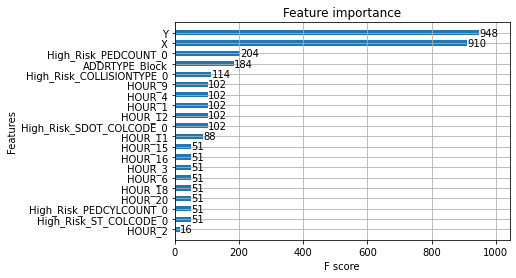

In [34]:
''' XGBoost Classifier '''
import os
import random
random.seed(2)
import xgboost as xgb

clf = xgb.XGBClassifier(max_depth=7, learning_rate=0.001, n_estimators=5000, 
                        verbosity=1, objective="binary:logistic", 
                        booster="gbtree", n_jobs=4, gamma=0, 
                        min_child_weight=1, max_delta_step=0, subsample=1, 
                        colsample_bytree=1, colsample_bylevel=1, colsample_bynode=1, 
                        reg_alpha=0, reg_lambda=1, scale_pos_weight=1, base_score=0.5, 
                        random_state=0)
clf.fit(X_train, y_train,
        eval_set=[(X_train, y_train), (X_test, y_test)],
        early_stopping_rounds=50, #stop if 50 consequent rounds without decrease of error
        verbose=False) # Change verbose to True if you want to see it train

plt.figsize=(16, 9)
xgb.plot_importance(clf, height=0.5, max_num_features=25)

clf_train_pred = clf.predict(X_train)
clf_test_pred = clf.predict(X_test)

# Evaluation
from sklearn.metrics import roc_auc_score, roc_curve, auc,mean_squared_error\
                            ,mean_absolute_error, confusion_matrix\
                            ,classification_report, accuracy_score, precision_score
                            
# Confusion Matrix
cm = confusion_matrix(y_test,clf_test_pred)
print("Test_Confusion_Matrix: \n",cm)

print("Train_ROC_AUC_Score: ",roc_auc_score(y_train, clf_train_pred))

print("Test_ROC_AUC_Score: ",roc_auc_score(y_test, clf_test_pred))

# Sensitivity
total=sum(sum(cm))
sensitivity1 = cm[1,1]/(cm[1,0]+cm[1,1])
print("Test_Sensitivity : ", sensitivity1 )

# Specificity
specificity1 = cm[0,0]/(cm[0,0]+cm[0,1])
print("Test_Specificity : ", specificity1)

# Accuracy
print("Test_Accuracy_Score:",accuracy_score(y_test, clf_test_pred))

print(classification_report(y_test, clf_test_pred))

# Results & Discussion <a name="a06"></a>

AUC, ROC, Sensitivity, Specificity, Precision, and Accuracy are compared for model evaluation. In the three models used in the current study, Naive Bayes has the highest Accuracy of 0.75; however, it has the lowest AUC, ROC score. Furthermore, its sensitivity is also low (at 0.2). Despite its high specificity value, Naive Bayes will not be considered. XGBoost and MLPClassifier both perform well, but as MLPClassifier slightly outperforms XGBoost, MLPClassifier will be selected as a final model.

In [35]:
# MLPClassifier
Test_Confusion_Matrix: 
 [[16792  9765]
 [ 2378  8933]]
Train_ROC_AUC_Score:  0.7115526574803149
Test_ROC_AUC_Score:  0.711031256769306
Test_Sensitivity :  0.789762178410397
Test_Specificity :  0.6323003351282148
Test_Accuracy_Score: 0.6793334741734446
              precision    recall  f1-score   support

           1       0.88      0.63      0.73     26557
           2       0.48      0.79      0.60     11311

    accuracy                           0.68     37868
   macro avg       0.68      0.71      0.66     37868
weighted avg       0.76      0.68      0.69     37868

# Naive Bayes
Test_Confusion_Matrix: 
 [[26273   284]
 [ 9043  2268]]
Train_ROC_AUC_Score:  0.5936080405814658
Test_ROC_AUC_Score:  0.5949093980930091
Test_Sensitivity :  0.20051277517460878
Test_Specificity :  0.9893060210114094
Test_Accuracy_Score: 0.7536970529206718
              precision    recall  f1-score   support

           1       0.74      0.99      0.85     26557
           2       0.89      0.20      0.33     11311

    accuracy                           0.75     37868
   macro avg       0.82      0.59      0.59     37868
weighted avg       0.79      0.75      0.69     37868

# XGBoost
Test_Confusion_Matrix: 
 [[16798  9759]
 [ 2400  8911]]
Train_ROC_AUC_Score:  0.7118129164142943
Test_ROC_AUC_Score:  0.7101717166945873
Test_Sensitivity :  0.7878171691273981
Test_Specificity :  0.6325262642617766
Test_Accuracy_Score: 0.6789109538396535
              precision    recall  f1-score   support

           1       0.87      0.63      0.73     26557
           2       0.48      0.79      0.59     11311

    accuracy                           0.68     37868
   macro avg       0.68      0.71      0.66     37868
weighted avg       0.76      0.68      0.69     37868


IndentationError: unindent does not match any outer indentation level (<tokenize>, line 12)

# Conclusion <a name="conclusion"></a>
The purpose of this project is to predict injury collisions and property damage collisions. The final model selected is the MLPClassifier, which provides AUC, ROC score of .71 and a detection rate of injury collisions equal to 79% and of property damage collisions equal to 63%. Its overall accuracy is 68%. This model will inform relevant stakeholders to predict injury and property damage collisions.